<a href="https://colab.research.google.com/github/sarashahin/Badger_AI/blob/main/Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pyyaml==5.1
import sys, os, distutils.core
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Install packages

!pip install xmltodict
!pip install opencv-python-headless



# Verifying installations
import torch, detectron2
print(torch.__version__, detectron2.__version__)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 5.3 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15713, done.
remote: Counting objects: 100% (436/436), done.
remote: Compressing objects: 100% (326/326), done.
remote: Total 15713 (delta 196), reused 296 (delta 104), pack-reused 15277
Receiving objects: 100% (15713/15713), 6.51 MiB | 10.01 MiB/s, done.
Resolving deltas: 100% (11312/11312), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 3.1 MB/s eta 0:0

2.2.1+cu121 0.6


In [ ]:
import os
import xmltodict
import json
from detectron2.structures import BoxMode

def convert_xml_to_coco(xml_folder, output_json, images_folder):
    coco_dict = {
        "info": {},
        "licenses": [],
        "images": [],
        "annotations": [],
        "categories": []
    }

    categories = {}
    annotation_id = 0
    image_id = 0  #  unique image ID

    for xml_file in os.listdir(xml_folder):
        if xml_file.endswith(".xml"):
            with open(os.path.join(xml_folder, xml_file)) as f:
                data_dict = xmltodict.parse(f.read())

            image_filename = data_dict['annotation']['filename']
            image_path = os.path.join(images_folder, image_filename)

            width = int(data_dict['annotation']['size']['width'])
            height = int(data_dict['annotation']['size']['height'])

            coco_dict["images"].append({
                "file_name": image_filename,
                "height": height,
                "width": width,
                "id": image_id
            })

            # Checking object key and process annotations
            if 'object' in data_dict['annotation']:
                objects = data_dict['annotation']['object']
                if isinstance(objects, dict):
                    objects = [objects]  # list objects

                for obj in objects:
                    if isinstance(obj, dict):
                        category = obj['name']
                        if category not in categories:
                            categories[category] = len(categories) + 1

                        bbox = obj['bndbox']
                        bbox = [int(bbox['xmin']), int(bbox['ymin']), int(bbox['xmax']), int(bbox['ymax'])]
                        bbox = [bbox[0], bbox[1], bbox[2] - bbox[0], bbox[3] - bbox[1]]  # convert to COCO format

                        coco_dict["annotations"].append({
                            "segmentation": [],
                            "area": bbox[2] * bbox[3],
                            "iscrowd": 0,
                            "image_id": image_id,
                            "bbox": bbox,
                            "category_id": categories[category],
                            "id": annotation_id,
                            "bbox_mode": BoxMode.XYWH_ABS
                        })
                        annotation_id += 1

            image_id += 1  # increase the image ID for each new image

    for category, category_id in categories.items():
        coco_dict["categories"].append({
            "id": category_id,
            "name": category
        })

    with open(output_json, 'w') as outfile:
        json.dump(coco_dict, outfile, indent=4)


    #  COCO format JSON to check
    print("Sample Images:", coco_dict["images"][:3])
    print("Sample Annotations:", coco_dict["annotations"][:3])
    print("Categories:", coco_dict["categories"])

convert_xml_to_coco('/content/drive/MyDrive/Annotation2', '/content/annotations.json', '/content/drive/MyDrive/extracted_frames')


Sample Images: [{'file_name': '2 badgers feeding 2_frame_0.jpg', 'height': 720, 'width': 1280, 'id': 0}, {'file_name': '2 badgers feeding 2_frame_60.jpg', 'height': 720, 'width': 1280, 'id': 1}, {'file_name': '2 badgers feeding 2_frame_120.jpg', 'height': 720, 'width': 1280, 'id': 2}]
Sample Annotations: [{'segmentation': [], 'area': 11845, 'iscrowd': 0, 'image_id': 0, 'bbox': [163, 349, 103, 115], 'category_id': 1, 'id': 0, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'segmentation': [], 'area': 10080, 'iscrowd': 0, 'image_id': 1, 'bbox': [211, 364, 90, 112], 'category_id': 1, 'id': 1, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'segmentation': [], 'area': 8216, 'iscrowd': 0, 'image_id': 2, 'bbox': [215, 364, 79, 104], 'category_id': 1, 'id': 2, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]
Categories: [{'id': 1, 'name': 'Badger_1_Face_Stripe'}, {'id': 2, 'name': 'Badger_2_Face_Stripe'}, {'id': 3, 'name': 'Badger_5_Fur_Grey'}, {'id': 4, 'name': 'Badger_3_Fur_Brown'}, {'id': 5, 'name': 'Badger_4_Fur_Grey'},

In [ ]:
import json
from sklearn.model_selection import train_test_split

# Load the annotations
with open('/content/annotations.json') as f:
    coco_annotations = json.load(f)

# Split the images into training and validation sets
images = coco_annotations['images']
train_images, val_images = train_test_split(images, test_size=0.2, random_state=42)

# Helper function to filter annotations
def filter_annotations(images, annotations):
    image_ids = [img['id'] for img in images]
    return [ann for ann in annotations if ann['image_id'] in image_ids]

# Create training and validation datasets
train_annotations = filter_annotations(train_images, coco_annotations['annotations'])
val_annotations = filter_annotations(val_images, coco_annotations['annotations'])


In [ ]:
import random

# Oversample underrepresented classes in the training dataset
category_counts = {}
for ann in train_annotations:
    category_id = ann['category_id']
    if category_id not in category_counts:
        category_counts[category_id] = 0
    category_counts[category_id] += 1

max_count = max(category_counts.values())
oversampled_annotations = []

# Find the maximum existing annotation ID
max_existing_id = max(ann['id'] for ann in train_annotations)

for category_id, count in category_counts.items():
    annotations_to_add = [ann for ann in train_annotations if ann['category_id'] == category_id]
    oversampled_annotations.extend(annotations_to_add)
    if count < max_count:
        additional_annotations = random.choices(annotations_to_add, k=max_count - count)
        for additional_annotation in additional_annotations:
            new_annotation = additional_annotation.copy()
            max_existing_id += 1
            new_annotation['id'] = max_existing_id  # double check unique ID
            oversampled_annotations.append(new_annotation)

train_annotations = oversampled_annotations

# check all IDs are unique
unique_id_set = set()
for ann in train_annotations:
    assert ann['id'] not in unique_id_set, f"Duplicate ID found: {ann['id']}"
    unique_id_set.add(ann['id'])

# Save the training dataset
train_data = coco_annotations.copy()
train_data['images'] = train_images
train_data['annotations'] = train_annotations

with open('/content/train_annotations.json', 'w') as f:
    json.dump(train_data, f, indent=4)

# Save the validation dataset
val_data = coco_annotations.copy()
val_data['images'] = val_images
val_data['annotations'] = val_annotations

with open('/content/val_annotations.json', 'w') as f:
    json.dump(val_data, f, indent=4)


In [ ]:
from detectron2.data.datasets import register_coco_instances

register_coco_instances("badger_train", {}, "/content/train_annotations.json", "/content/drive/MyDrive/extracted_frames")
register_coco_instances("badger_val", {}, "/content/val_annotations.json", "/content/drive/MyDrive/extracted_frames")

from detectron2.data import MetadataCatalog, DatasetCatalog
badger_metadata = MetadataCatalog.get("badger_train")
dataset_dicts = DatasetCatalog.get("badger_train")


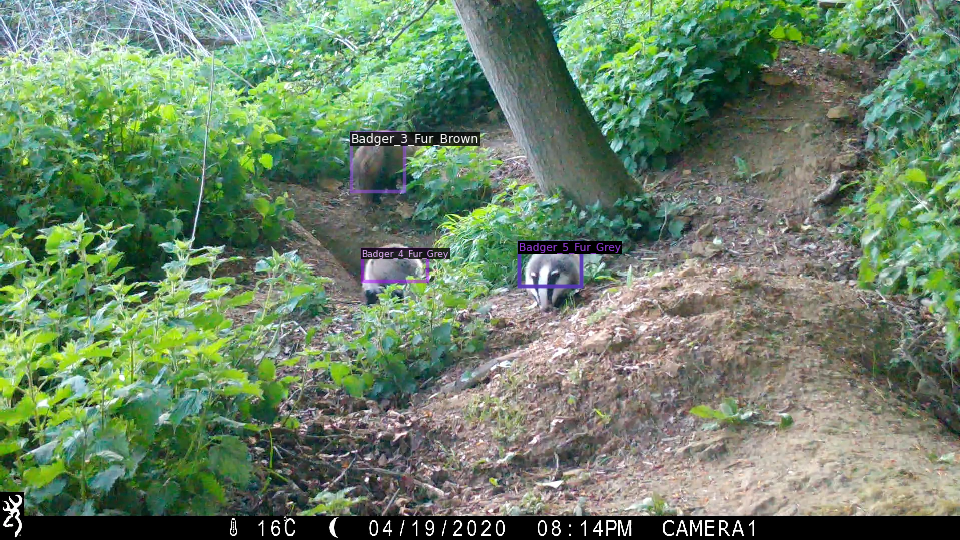

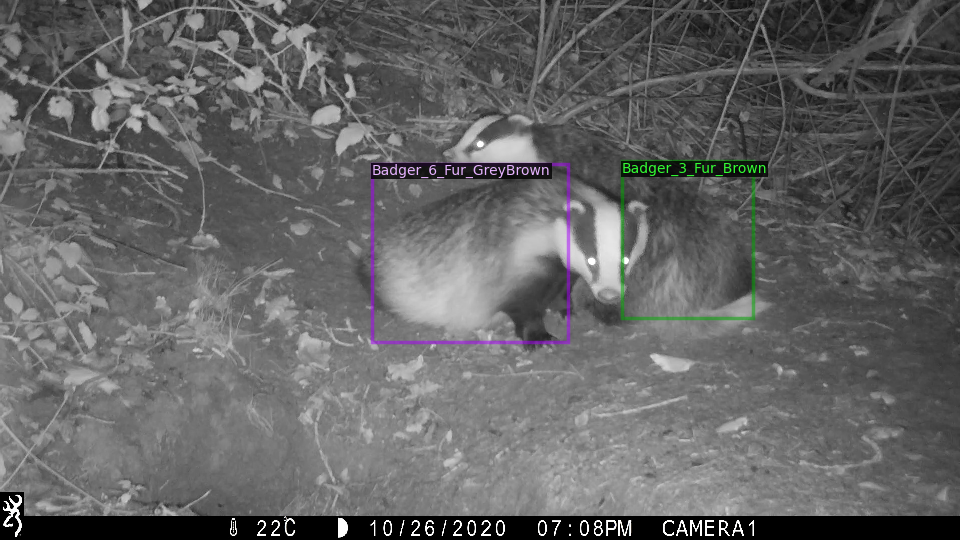

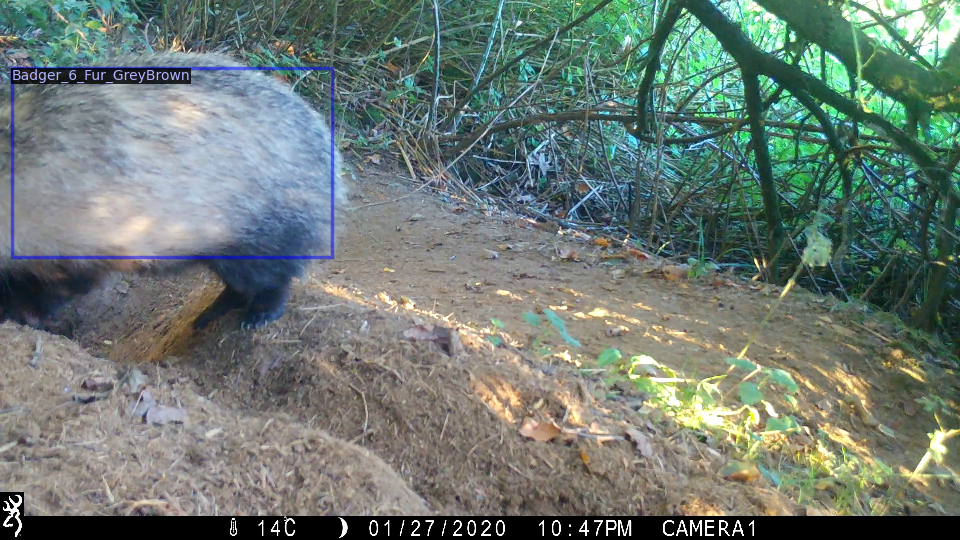

In [ ]:
import random
import cv2
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow

for d in random.sample(dataset_dicts, 3):
    img_path = os.path.join("/content/drive/MyDrive/extracted_frames", d["file_name"])
    img = cv2.imread(img_path)
    visualizer = Visualizer(img[:, :, ::-1], metadata=badger_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])


In [ ]:
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer
from detectron2.data import build_detection_train_loader, DatasetMapper
import detectron2.data.transforms as T
from detectron2.solver import WarmupCosineLR

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("badger_train",)
cfg.DATASETS.TEST = ("badger_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0004
cfg.SOLVER.WARMUP_FACTOR = 1.0 / 1000
cfg.SOLVER.WEIGHT_DECAY = 0.0001
cfg.SOLVER.MAX_ITER = 4000
cfg.SOLVER.BIAS_LR_FACTOR = 2.0
cfg.SOLVER.MOMENTUM = 0.9
cfg.SOLVER.LR_SCHEDULER_NAME = "WarmupCosineLR"
cfg.MODEL.BACKBONE.FREEZE_AT = 2
cfg.MODEL.ROI_BOX_HEAD.DROPOUT_PROB = 0.5  # dropout layer
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 14

trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


[05/30 19:02:41 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
model_final_68b088.pkl: 421MB [00:02, 170MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/30 19:02:44 d2.engine.train_loop]: Starting training from iteration 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/30 19:03:35 d2.utils.events]:  eta: 2:35:14  iter: 19  total_loss: 3.321  loss_cls: 2.857  loss_box_reg: 0.295  loss_rpn_cls: 0.1212  loss_rpn_loc: 0.0137    time: 2.2062  last_time: 2.3201  data_time: 0.0677  last_data_time: 0.0061   lr: 6.8794e-06  max_mem: 5723M
[05/30 19:04:26 d2.utils.events]:  eta: 2:36:49  iter: 39  total_loss: 3.209  loss_cls: 2.604  loss_box_reg: 0.418  loss_rpn_cls: 0.1242  loss_rpn_loc: 0.01745    time: 2.2878  last_time: 2.4304  data_time: 0.0096  last_data_time: 0.0073   lr: 1.37e-05  max_mem: 5724M
[05/30 19:05:11 d2.utils.events]:  eta: 2:35:30  iter: 59  total_loss: 2.593  loss_cls: 2.066  loss_box_reg: 0.4021  loss_rpn_cls: 0.157  loss_rpn_loc: 0.01804    time: 2.2811  last_time: 2.4327  data_time: 0.0077  last_data_time: 0.0058   lr: 2.052e-05  max_mem: 5725M
[05/30 19:05:59 d2.utils.events]:  eta: 2:35:13  iter: 79  total_loss: 1.821  loss_cls: 1.259  loss_box_reg: 0.344  loss_rpn_cls: 0.2193  loss_rpn_loc: 0.02133    time: 2.3028  last_time: 2.4

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.engine import DefaultPredictor

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("badger_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "badger_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))


[05/30 21:37:21 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
[05/30 21:37:22 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
[05/30 21:37:22 d2.data.datasets.coco]: Loaded 153 images in COCO format from /content/val_annotations.json
[05/30 21:37:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/30 21:37:22 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/30 21:37:22 d2.data.common]: Serializing 153 elements to byte tensors and concatenating them all ...
[05/30 21:37:22 d2.data.common]: Serialized dataset takes 0.04 MiB
[05/30 21:37:22 d2.evaluation.evaluator]: Start inference on 153 batches


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[05/30 21:37:26 d2.evaluation.evaluator]: Inference done 11/153. Dataloading: 0.0073 s/iter. Inference: 0.2895 s/iter. Eval: 0.0007 s/iter. Total: 0.2974 s/iter. ETA=0:00:42
[05/30 21:37:31 d2.evaluation.evaluator]: Inference done 28/153. Dataloading: 0.0083 s/iter. Inference: 0.2910 s/iter. Eval: 0.0006 s/iter. Total: 0.3008 s/iter. ETA=0:00:37
[05/30 21:37:36 d2.evaluation.evaluator]: Inference done 45/153. Dataloading: 0.0071 s/iter. Inference: 0.2901 s/iter. Eval: 0.0007 s/iter. Total: 0.2986 s/iter. ETA=0:00:32
[05/30 21:37:42 d2.evaluation.evaluator]: Inference done 63/153. Dataloading: 0.0060 s/iter. Inference: 0.2870 s/iter. Eval: 0.0006 s/iter. Total: 0.2941 s/iter. ETA=0:00:26
[05/30 21:37:47 d2.evaluation.evaluator]: Inference done 80/153. Dataloading: 0.0069 s/iter. Inference: 0.2870 s/iter. Eval: 0.0005 s/iter. Total: 0.2948 s/iter. ETA=0:00:21
[05/30 21:37:52 d2.evaluation.evaluator]: Inference done 97/153. Dataloading: 0.0066 s/iter. Inference: 0.2894 s/iter. Eval: 0.000

# Evaluations

[05/30 21:42:04 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


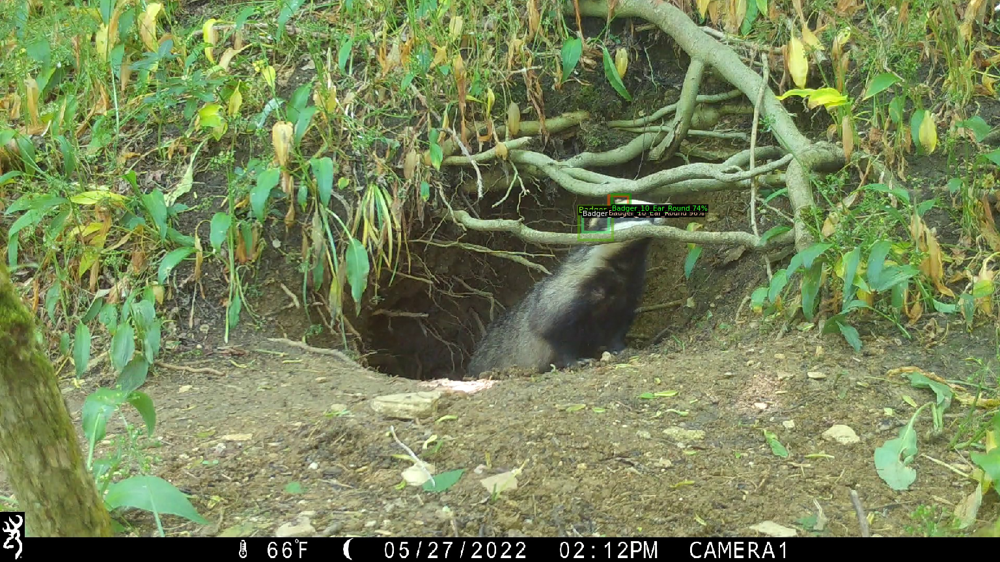

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
import cv2
from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import ColorMode
from detectron2.data.datasets import load_coco_json

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # threshold for this model
predictor = DefaultPredictor(cfg)

# Run inference on an image
image_path = "/content/drive/MyDrive/extracted_frames/IMG_0003_frame_4980.jpg"
im = cv2.imread(image_path)
outputs = predictor(im)

# Visualize
v = Visualizer(im[:, :, ::-1], metadata=badger_metadata, scale=0.8)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])






[05/30 22:06:16 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


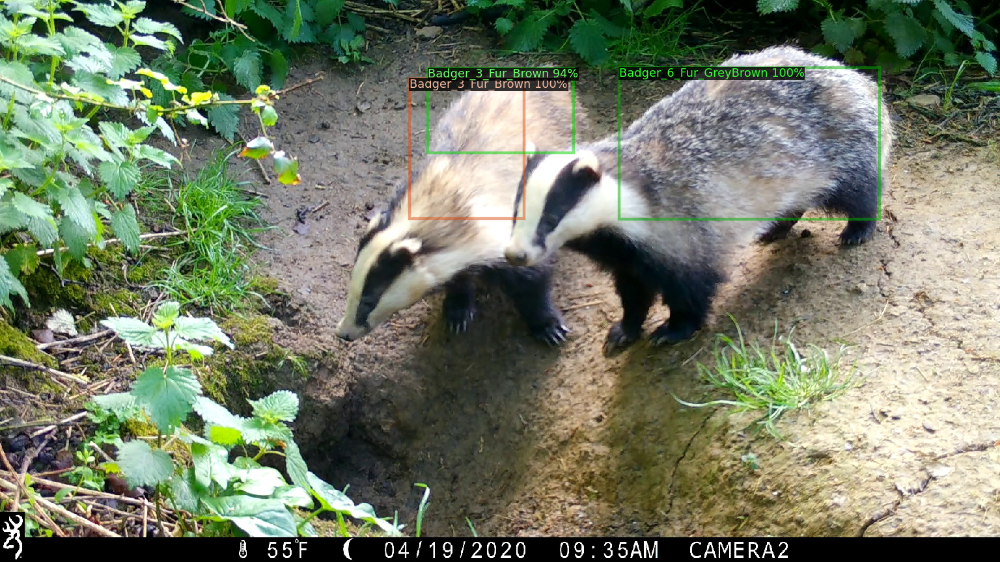

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
import cv2
from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import ColorMode
import os

# Load the trained model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  #  threshold for this model
predictor = DefaultPredictor(cfg)


image_path = "/content/drive/MyDrive/extracted_frames/boar_sow_with_cubs_frame_1560.jpg"
im = cv2.imread(image_path)
if im is None:
    raise ValueError(f"Image at path {image_path} not found or unable to load.")
outputs = predictor(im)

# Visualize the results with masks and colors
v = Visualizer(im[:, :, ::-1], metadata=badger_metadata, scale=0.8, instance_mode=ColorMode.IMAGE)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])


[05/30 23:06:53 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
[05/30 23:06:54 d2.data.datasets.coco]: Loaded 153 images in COCO format from /content/val_annotations.json


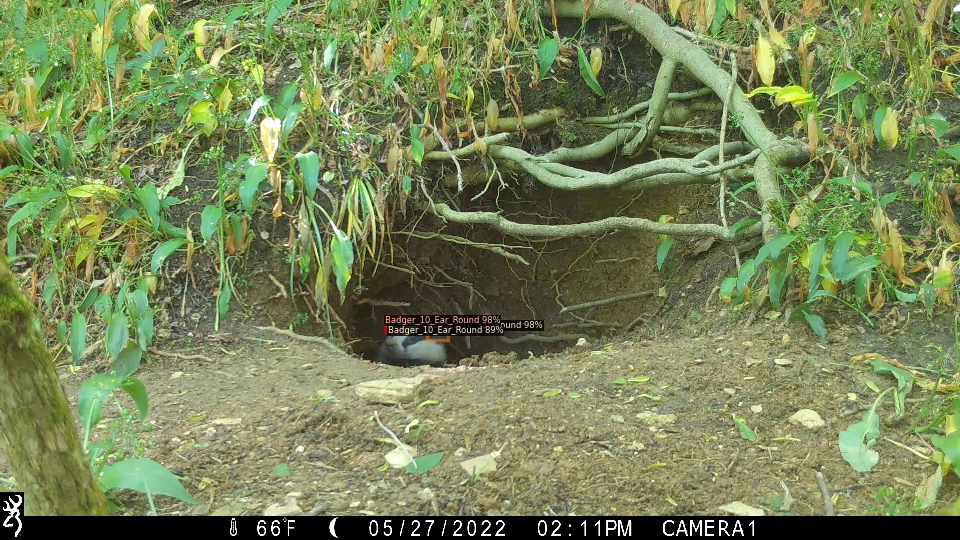

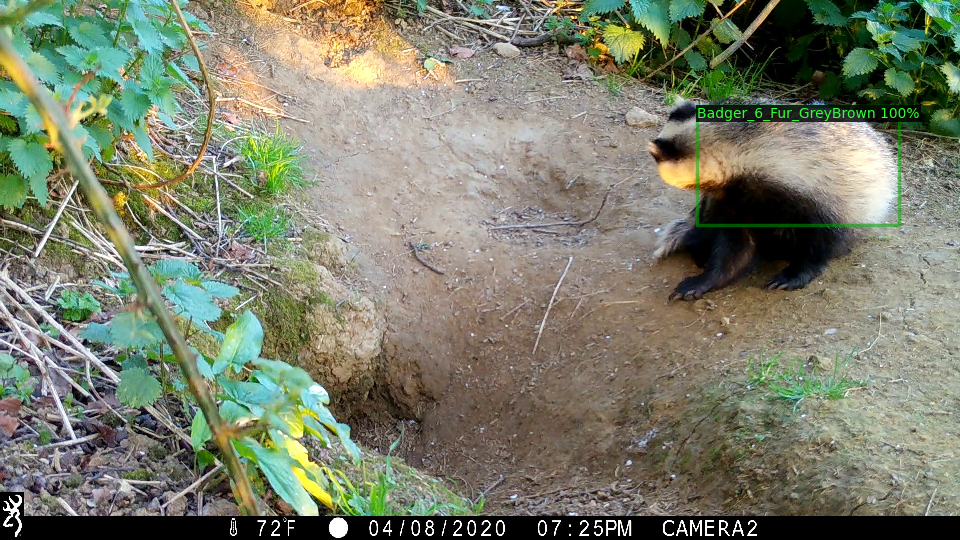

In [ ]:
from detectron2.utils.visualizer import Visualizer
from detectron2.data.datasets import load_coco_json
import random

# inferences are using the config with parameters that are used in training
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   #  threshold
predictor = DefaultPredictor(cfg)

# Load the validation dataset
dataset_dicts = DatasetCatalog.get("badger_val")

for d in random.sample(dataset_dicts, 2):
    im = cv2.imread(d["file_name"])
    if im is None:
        raise ValueError(f"Image at path {d['file_name']} not found or unable to load.")
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=badger_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE  # colors for segmented areas
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])


In [ ]:
# #  New data for evalution, unseen data


# from detectron2.engine import DefaultPredictor
# from detectron2.utils.visualizer import Visualizer
# import cv2
# from google.colab.patches import cv2_imshow
# from detectron2.utils.visualizer import ColorMode
# import os

# # Load the trained model
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # threshold for this model
# predictor = DefaultPredictor(cfg)

# # Paths
# image_path = "/content/drive/MyDrive/Badger Photos/DSC_2518.JPG"
# im = cv2.imread(image_path)
# outputs = predictor(im)

# # Visualize the results
# v = Visualizer(im[:, :, ::-1], metadata=badger_metadata, scale=0.8, instance_mode=ColorMode.IMAGE)
# out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
# cv2_imshow(out.get_image()[:, :, ::-1])


[05/30 23:08:50 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
Checking images in directory: /content/drive/MyDrive/Badger Photos
Found images: ['/content/drive/MyDrive/Badger Photos/DSC_2354.JPG', '/content/drive/MyDrive/Badger Photos/DSC_2343.JPG', '/content/drive/MyDrive/Badger Photos/DSC_2356.JPG', '/content/drive/MyDrive/Badger Photos/DSC_2342.JPG', '/content/drive/MyDrive/Badger Photos/DSC_2593.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0140.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0346.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0024.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0342.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0347.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0209.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0208.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0022.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0073.JPG', '/content/drive/MyDrive/Badger Photos/IMG_0075.JPG', '/co

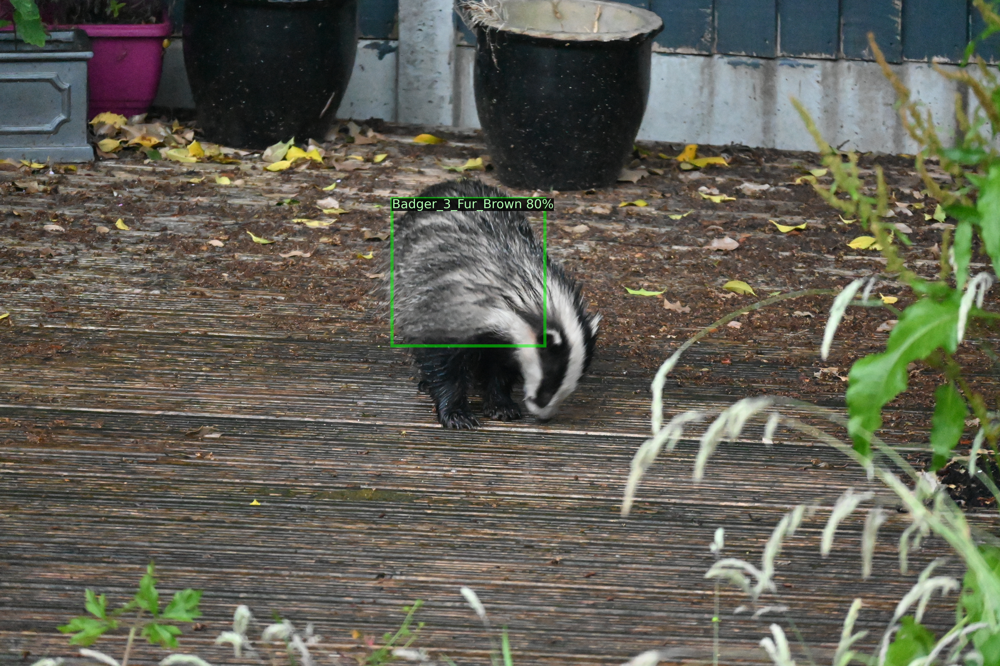

Processing image: /content/drive/MyDrive/Badger Photos/IMG_0200.JPG


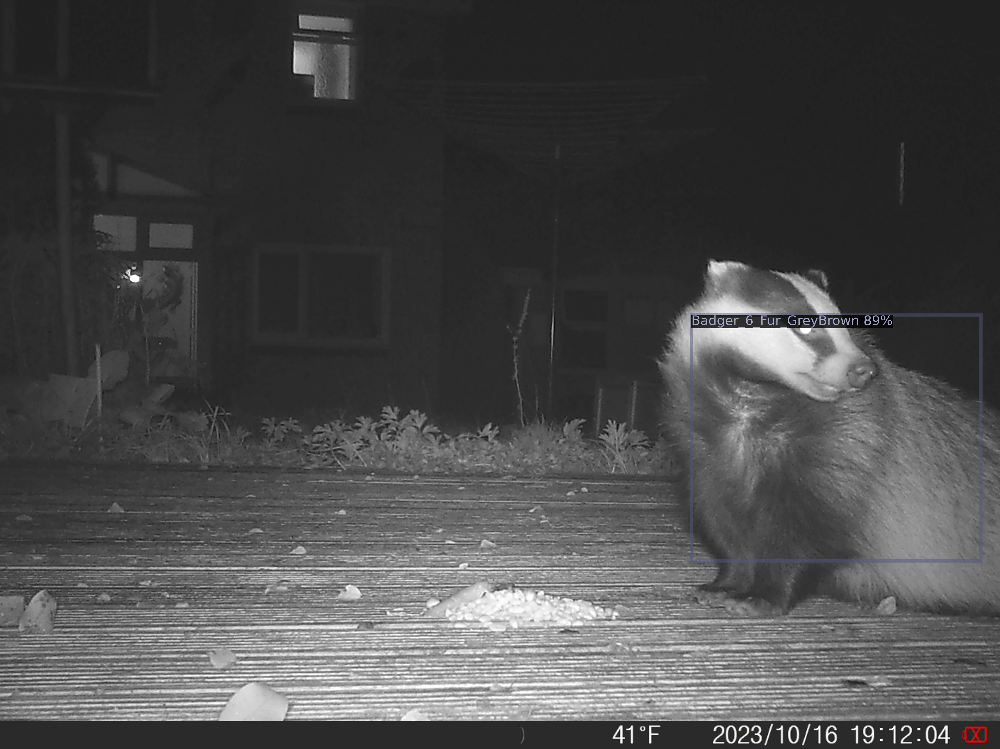

In [ ]:
#  New data for evalution, unseen data, random images

from detectron2.engine import DefaultPredictor
from detectron2.utils.visualizer import Visualizer
import cv2
from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import ColorMode
import os
import random

# Load the trained model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # threshold
predictor = DefaultPredictor(cfg)


external_images_dir = "/content/drive/MyDrive/Badger Photos"


print(f"Checking images in directory: {external_images_dir}")

# list of images
all_images = [os.path.join(external_images_dir, img) for img in os.listdir(external_images_dir) if img.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Debugging
print(f"Found images: {all_images}")

# Check images
if not all_images:
    raise ValueError(f"No images found in directory {external_images_dir}")

# Randomly  images
sampled_images = random.sample(all_images, min(2, len(all_images)))

# Process and visualize each image
for image_path in sampled_images:
    print(f"Processing image: {image_path}")
    im = cv2.imread(image_path)
    if im is None:
        raise ValueError(f"Image at path {image_path} not found or unable to load.")

    outputs = predictor(im)

    # Visualize the results with masks and colors
    v = Visualizer(im[:, :, ::-1], metadata=badger_metadata, scale=0.8, instance_mode=ColorMode.IMAGE)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])


Refrence:/

https://ai.meta.com/tools/detectron2/